In [46]:
import yfinance as yf
import pandas as pd
import datetime as dt
import matplotlib.pyplot as plt
!pip install seaborn
import seaborn as sns
import plotly.express as px

# Define ticker symbols
tickers = ['AMZN', 'JPM', 'META', 'PG', 'GOOGL', 'CAT', 'PFE', 'EXC', 'DE', 'JNJ']

# Define start and end dates
start = dt.datetime(2018, 1, 1)
end = dt.datetime.now()

# Download data for all tickers with 'Adj Close' included
df = yf.download(tickers, start=start, end=end, auto_adjust=False)

# Reset index to include 'Date' column
df.reset_index(inplace=True)

# Reorder columns to match the required format
df = df[['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Adj Close']]

# Save to your Downloads folder
df.to_csv("~/Downloads/stock_data.csv", index=False)

print("✅ stock_data.csv file saved successfully with all stocks and correct column order!")


[*********************100%***********************]  10 of 10 completed


✅ stock_data.csv file saved successfully with all stocks and correct column order!


In [47]:
import yfinance as yf
import pandas as pd
import datetime as dt

# Define stock ticker and date range
ticker = "AMZN"
start_date = "2018-01-11"
end_date = dt.datetime.today().strftime('%Y-%m-%d')

# Download Amazon's data separately to avoid multi-index issues
amazon_df = yf.download(ticker, start=start_date, end=end_date, auto_adjust=False)

# Reset index to include 'Date' column
amazon_df.reset_index(inplace=True)

# Reorder columns to match stock_data.csv format
amazon_df = amazon_df[['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Adj Close']]

# Save to CSV in Downloads folder
amazon_df.to_csv("Amazon.csv", index=False)

print("✅ Amazon.csv file saved successfully with correct columns and time span!")


[*********************100%***********************]  1 of 1 completed

✅ Amazon.csv file saved successfully with correct columns and time span!


In [48]:
# Use Pandas to read stock data (the csv file is included in the course package) 
stock_df = pd.read_csv('Amazon.csv')
stock_df.head(15)

,Date,Open,High,Low,Close,Volume,Adj Close
0,NaN,AMZN,AMZN,AMZN,AMZN,AMZN,AMZN
1,2018-01-11,62.98699951171875,63.8385009765625,62.823001861572266,63.83399963378906,62500000,63.83399963378906
2,2018-01-12,63.669498443603516,65.28800201416016,63.669498443603516,65.26000213623047,108874000,65.26000213623047
3,2018-01-16,66.1500015258789,66.99700164794922,64.61499786376953,65.24299621582031,144414000,65.24299621582031
4,2018-01-17,65.61199951171875,65.69999694824219,64.04399871826172,64.75,105076000,64.75
5,2018-01-18,64.69750213623047,65.2300033569336,64.20099639892578,64.66600036621094,80538000,64.66600036621094
6,2018-01-19,65.5999984741211,65.6500015258789,64.64949798583984,64.72899627685547,91570000,64.72899627685547
7,2018-01-22,64.8584976196289,66.37249755859375,64.83300018310547,66.3655014038086,82802000,66.3655014038086
8,2018-01-23,66.90450286865234,68.24500274658203,66.86699676513672,68.12699890136719,103386000,68.12699890136719
9,2018-01-24,68.74099731445312,69.40799713134766,66.9000015258789,67.87550354003906,136150000,67.87550354003906


In [49]:
# Count the number of missing values in "stock_df" Pandas DataFrame
stock_df.isnull().sum()

Date         1
Open         0
High         0
Low          0
Close        0
Volume       0
Adj Close    0
dtype: int64

In [50]:
# Obtain information about the Pandas DataFrame such as data types, memory utilization..etc
stock_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1795 entries, 0 to 1794
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Date       1794 non-null   object
 1   Open       1795 non-null   object
 2   High       1795 non-null   object
 3   Low        1795 non-null   object
 4   Close      1795 non-null   object
 5   Volume     1795 non-null   object
 6   Adj Close  1795 non-null   object
dtypes: object(7)
memory usage: 98.3+ KB


In [51]:
# Define stock ticker (JPMorgan Chase & Co.)
ticker = "JPM"

# Define start date (same as stock_data.csv)
start_date = "2018-01-11"

# Define today's date
end_date = dt.datetime.today().strftime('%Y-%m-%d')

# Download JPM stock data with 'Adj Close' included
jpm_df = yf.download(ticker, start=start_date, end=end_date, auto_adjust=False)

# Reset index to include 'Date' column
jpm_df.reset_index(inplace=True)

# Reorder columns to match the stock_data.csv format
jpm_df = jpm_df[['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Adj Close']]

# Save to CSV in Downloads folder
jpm_df.to_csv("JPM.csv", index=False)

print("✅ JPM.csv file saved successfully with correct columns and time span!")


[*********************100%***********************]  1 of 1 completed

✅ JPM.csv file saved successfully with correct columns and time span!


In [52]:
import pandas as pd

# Load JPMorgan Chase & Co. stock data into a Pandas DataFrame
JPM_df = pd.read_csv("JPM.csv", parse_dates=["Date"])

# Count the number of null or missing values in JPM_df
missing_values = JPM_df.isnull().sum()

# Get the memory usage of JPM_df
memory_usage = JPM_df.memory_usage(deep=True).sum()

# Print results
print("✅ JPMorgan Chase & Co. DataFrame Loaded!")
print("\n🔍 Missing Values:\n", missing_values)
print("\n💾 Memory Usage (bytes):", memory_usage)


✅ JPMorgan Chase & Co. DataFrame Loaded!

🔍 Missing Values:
 Date         1
Open         0
High         0
Low          0
Close        0
Volume       0
Adj Close    0
dtype: int64

💾 Memory Usage (bytes): 708086


In [53]:
# Ensure 'Adj Close' column is numeric
stock_df['Adj Close'] = pd.to_numeric(stock_df['Adj Close'], errors='coerce')

# Calculate the percentage daily return
stock_df['Daily Return'] = stock_df['Adj Close'].pct_change(1) * 100

# Display the DataFrame to verify
print(stock_df.head())


         Date                Open               High                 Low  \
0         NaN                AMZN               AMZN                AMZN   
1  2018-01-11   62.98699951171875   63.8385009765625  62.823001861572266   
2  2018-01-12  63.669498443603516  65.28800201416016  63.669498443603516   
3  2018-01-16    66.1500015258789  66.99700164794922   64.61499786376953   
4  2018-01-17   65.61199951171875  65.69999694824219   64.04399871826172   

               Close     Volume  Adj Close  Daily Return  
0               AMZN       AMZN        NaN           NaN  
1  63.83399963378906   62500000  63.834000           NaN  
2  65.26000213623047  108874000  65.260002      2.233923  
3  65.24299621582031  144414000  65.242996     -0.026059  
4              64.75  105076000  64.750000     -0.755631  


In [54]:
# Let's replace the first row with zeros instead of NaN
stock_df['Daily Return'].replace(np.nan, 0, inplace = True)
stock_df

/var/folders/s0/hts3dbss56x0x2f85v7w1p6r0000gn/T/ipykernel_91311/4192783257.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  stock_df['Daily Return'].replace(np.nan, 0, inplace = True)


,Date,Open,High,Low,Close,Volume,Adj Close,Daily Return
0,NaN,AMZN,AMZN,AMZN,AMZN,AMZN,NaN,0.000000
1,2018-01-11,62.98699951171875,63.8385009765625,62.823001861572266,63.83399963378906,62500000,63.834000,0.000000
2,2018-01-12,63.669498443603516,65.28800201416016,63.669498443603516,65.26000213623047,108874000,65.260002,2.233923
3,2018-01-16,66.1500015258789,66.99700164794922,64.61499786376953,65.24299621582031,144414000,65.242996,-0.026059
4,2018-01-17,65.61199951171875,65.69999694824219,64.04399871826172,64.75,105076000,64.750000,-0.755631
...,...,...,...,...,...,...,...,...
1790,2025-02-25,211.6300048828125,213.33999633789062,204.16000366210938,212.8000030517578,58958000,212.800003,0.042309
1791,2025-02-26,214.94000244140625,218.16000366210938,213.08999633789062,214.35000610351562,39120600,214.350006,0.728385
1792,2025-02-27,218.35000610351562,219.97000122070312,208.3699951171875,208.74000549316406,40548600,208.740005,-2.617215
1793,2025-02-28,208.64999389648438,212.6199951171875,206.99000549316406,212.27999877929688,51771700,212.279999,1.695886


In [55]:
# Use the describe() method to obtain a statistical summary about the data 
# Over the specified time period, the average adjusted close price for Amazon stock was $120.07 
# The maximum adjusted close price was $186.57
# The maximum volume of shares traded on one day were 311,346,000
stock_df.describe().round(2)

,Adj Close,Daily Return
count,1794.00,1795.00
mean,131.74,0.09
std,40.88,2.16
min,63.83,-14.05
25%,93.21,-1.02
50%,129.08,0.10
75%,164.96,1.22
max,242.06,13.54


In [80]:
# Matplotlib is a comprehensive data visualization library in Python 
# Seaborn is a visualization library that sits on top of matplotlib and offers enhanced features 
# plotly.express module contains functions that can create interactive figures using a few lines of code

import pandas as pd
import plotly.express as px
import plotly.io as pio
pio.renderers.default = "notebook"  # Use "notebook" renderer for Jupyter


In [90]:
import pandas as pd
import plotly.express as px

# Load Amazon.csv into stock_df (Ensure Date is parsed correctly)
stock_df = pd.read_csv("Amazon.csv", parse_dates=["Date"])

# Convert Date column explicitly to datetime and sort
stock_df["Date"] = pd.to_datetime(stock_df["Date"], errors="coerce")
stock_df = stock_df.sort_values("Date")

# Ensure 'Adj Close' is numeric
stock_df["Adj Close"] = pd.to_numeric(stock_df["Adj Close"], errors="coerce")

# Plot with correct x-axis formatting
fig = px.line(stock_df, x="Date", y="Adj Close", title="Amazon.com, Inc. (AMZN) Adjusted Closing Price [$]")

# Force Plotly to recognize Date as a time-series
fig.update_xaxes(
    type="date",
    tickformat="%Y-%m-%d",
    tickangle=-45,
    tickmode="auto",
    nticks=12
)

# Show the plot
fig.show()


In [91]:
stock_df

,Date,Open,High,Low,Close,Volume,Adj Close
1,2018-01-11,62.98699951171875,63.8385009765625,62.823001861572266,63.83399963378906,62500000,63.834000
2,2018-01-12,63.669498443603516,65.28800201416016,63.669498443603516,65.26000213623047,108874000,65.260002
3,2018-01-16,66.1500015258789,66.99700164794922,64.61499786376953,65.24299621582031,144414000,65.242996
4,2018-01-17,65.61199951171875,65.69999694824219,64.04399871826172,64.75,105076000,64.750000
5,2018-01-18,64.69750213623047,65.2300033569336,64.20099639892578,64.66600036621094,80538000,64.666000
...,...,...,...,...,...,...,...
1791,2025-02-26,214.94000244140625,218.16000366210938,213.08999633789062,214.35000610351562,39120600,214.350006
1792,2025-02-27,218.35000610351562,219.97000122070312,208.3699951171875,208.74000549316406,40548600,208.740005
1793,2025-02-28,208.64999389648438,212.6199951171875,206.99000549316406,212.27999877929688,51771700,212.279999
1794,2025-03-03,213.35000610351562,214.00999450683594,202.5500030517578,205.02000427246094,42948400,205.020004


In [94]:
# Ensure "Date" is parsed correctly
stock_df["Date"] = pd.to_datetime(stock_df["Date"], errors="coerce")

# Convert "Volume" column to numeric
stock_df["Volume"] = pd.to_numeric(stock_df["Volume"], errors="coerce")

# Re-run the plot function
plot_financial_data(stock_df.iloc[:, [0, 5]], 'Amazon.com, Inc. (AMZN) Trading Volume')

# Define a function that performs interactive data visualization using Plotly Express
def plot_financial_data(df, title):
    
    fig = px.line(title = title)
    
    # For loop that plots all stock prices in the pandas dataframe df
    # Note that index starts with 1 because we want to skip the date column
    
    for i in df.columns[1:]:
        fig.add_scatter(x = df['Date'], y = df[i], name = i)
        fig.update_traces(line_width = 5)
        fig.update_layout({'plot_bgcolor': "white"})

    fig.show()

In [99]:
# # Plot % Daily Returns
stock_df["Daily Return"] = stock_df["Adj Close"].pct_change() * 100

plot_financial_data(stock_df.iloc[:,[0,7]], 'Amazon.com, Inc. (AMZN) Percentage Daily Return [%]')


/var/folders/s0/hts3dbss56x0x2f85v7w1p6r0000gn/T/ipykernel_91311/1536445582.py:2: FutureWarning:

The default fill_method='pad' in Series.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



PERFORM DATA VISUALIZATION FOR A SINGLE STOCK: PART 2

In [101]:
# Define a function that classifies the returns based on the magnitude
# Feel free to change these numbers
def percentage_return_classifier(percentage_return):
    
    if percentage_return > -0.3 and percentage_return <= 0.3:
        return 'Insignificant Change'
    elif percentage_return > 0.3 and percentage_return <= 3:
        return 'Positive Change'
    elif percentage_return > -3 and percentage_return <= -0.3:
        return 'Negative Change'
    elif percentage_return > 3 and percentage_return <= 7:
        return 'Large Positive Change'
    elif percentage_return > -7 and percentage_return <= -3:
        return 'Large Negative Change'
    elif percentage_return > 7:
        return 'Bull Run'
    elif percentage_return <= -7:
        return 'Bear Sell Off'

In [102]:
# Apply the function to the "Daily Return" Column and place the result in "Trend" column
stock_df['Trend'] = stock_df['Daily Return'].apply(percentage_return_classifier)
stock_df

,Date,Open,High,Low,Close,Volume,Adj Close,Daily Return,Trend
1,2018-01-11,62.98699951171875,63.8385009765625,62.823001861572266,63.83399963378906,62500000.0,63.834000,NaN,None
2,2018-01-12,63.669498443603516,65.28800201416016,63.669498443603516,65.26000213623047,108874000.0,65.260002,2.233923,Positive Change
3,2018-01-16,66.1500015258789,66.99700164794922,64.61499786376953,65.24299621582031,144414000.0,65.242996,-0.026059,Insignificant Change
4,2018-01-17,65.61199951171875,65.69999694824219,64.04399871826172,64.75,105076000.0,64.750000,-0.755631,Negative Change
5,2018-01-18,64.69750213623047,65.2300033569336,64.20099639892578,64.66600036621094,80538000.0,64.666000,-0.129729,Insignificant Change
...,...,...,...,...,...,...,...,...,...
1791,2025-02-26,214.94000244140625,218.16000366210938,213.08999633789062,214.35000610351562,39120600.0,214.350006,0.728385,Positive Change
1792,2025-02-27,218.35000610351562,219.97000122070312,208.3699951171875,208.74000549316406,40548600.0,208.740005,-2.617215,Negative Change
1793,2025-02-28,208.64999389648438,212.6199951171875,206.99000549316406,212.27999877929688,51771700.0,212.279999,1.695886,Positive Change
1794,2025-03-03,213.35000610351562,214.00999450683594,202.5500030517578,205.02000427246094,42948400.0,205.020004,-3.420009,Large Negative Change


In [103]:
# Count distinct values in the Trend column
trend_summary = stock_df['Trend'].value_counts()
trend_summary

Trend
Positive Change          680
Negative Change          596
Insignificant Change     282
Large Positive Change    112
Large Negative Change    102
Bull Run                  11
Bear Sell Off             11
Name: count, dtype: int64

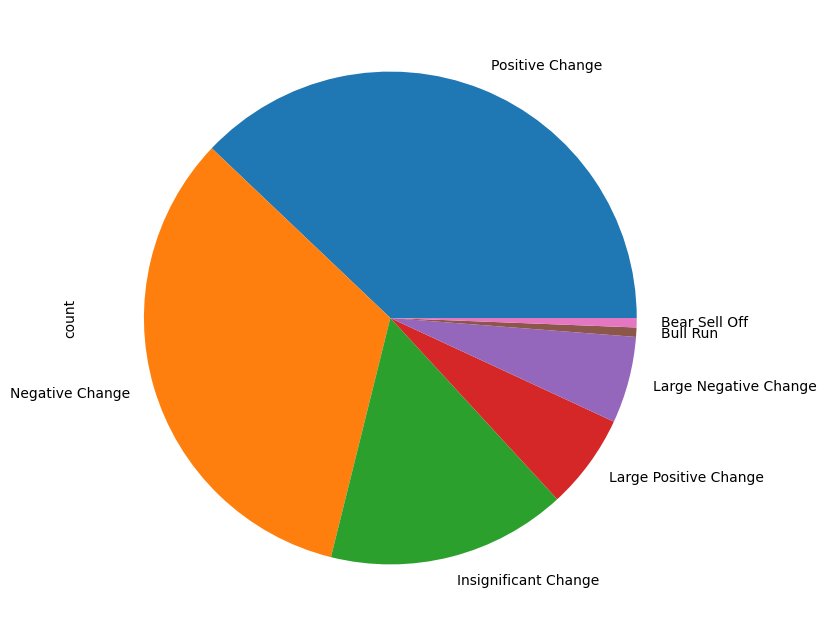

In [104]:
# Plot a pie chart using Matplotlib Library
plt.figure(figsize = (8, 8))
trend_summary.plot(kind = 'pie', y = 'Trend');

In [105]:
# Let's plot a candlestick graph using Cufflinks library
# Cufflinks is a powerful Python library that connects Pandas and Plotly for generating plots using few lines of code
# Cufflinks allows for interactive data visualization
! pip install cufflinks
import cufflinks as cf

cf.go_offline() # Enabling offline mode for interactive data visualization locally


  Preparing metadata (setup.py) ... done
  Created wheel for cufflinks: filename=cufflinks-0.17.3-py3-none-any.whl size=67940 sha256=e334f16e8ee2252e7fefdcb0072563702c7ccbacc97376d2274db2ca7c9ea1f4
  Stored in directory: /Users/tomaszosuchowski/Library/Caches/pip/wheels/c0/d9/70/372130dacf508192607c1a7359c7bf0656b1a3b79f6cf66f7a
Successfully built cufflinks


In [106]:
stock_df

,Date,Open,High,Low,Close,Volume,Adj Close,Daily Return,Trend
1,2018-01-11,62.98699951171875,63.8385009765625,62.823001861572266,63.83399963378906,62500000.0,63.834000,NaN,None
2,2018-01-12,63.669498443603516,65.28800201416016,63.669498443603516,65.26000213623047,108874000.0,65.260002,2.233923,Positive Change
3,2018-01-16,66.1500015258789,66.99700164794922,64.61499786376953,65.24299621582031,144414000.0,65.242996,-0.026059,Insignificant Change
4,2018-01-17,65.61199951171875,65.69999694824219,64.04399871826172,64.75,105076000.0,64.750000,-0.755631,Negative Change
5,2018-01-18,64.69750213623047,65.2300033569336,64.20099639892578,64.66600036621094,80538000.0,64.666000,-0.129729,Insignificant Change
...,...,...,...,...,...,...,...,...,...
1791,2025-02-26,214.94000244140625,218.16000366210938,213.08999633789062,214.35000610351562,39120600.0,214.350006,0.728385,Positive Change
1792,2025-02-27,218.35000610351562,219.97000122070312,208.3699951171875,208.74000549316406,40548600.0,208.740005,-2.617215,Negative Change
1793,2025-02-28,208.64999389648438,212.6199951171875,206.99000549316406,212.27999877929688,51771700.0,212.279999,1.695886,Positive Change
1794,2025-03-03,213.35000610351562,214.00999450683594,202.5500030517578,205.02000427246094,42948400.0,205.020004,-3.420009,Large Negative Change


In [107]:
# Set the date to be the index for the Pandas DataFrame
# This is critical to show the date on the x-axis when using cufflinks
stock_df.set_index(['Date'], inplace = True)
stock_df

,Open,High,Low,Close,Volume,Adj Close,Daily Return,Trend
Date,,,,,,,,
2018-01-11,62.98699951171875,63.8385009765625,62.823001861572266,63.83399963378906,62500000.0,63.834000,NaN,None
2018-01-12,63.669498443603516,65.28800201416016,63.669498443603516,65.26000213623047,108874000.0,65.260002,2.233923,Positive Change
2018-01-16,66.1500015258789,66.99700164794922,64.61499786376953,65.24299621582031,144414000.0,65.242996,-0.026059,Insignificant Change
2018-01-17,65.61199951171875,65.69999694824219,64.04399871826172,64.75,105076000.0,64.750000,-0.755631,Negative Change
2018-01-18,64.69750213623047,65.2300033569336,64.20099639892578,64.66600036621094,80538000.0,64.666000,-0.129729,Insignificant Change
...,...,...,...,...,...,...,...,...
2025-02-26,214.94000244140625,218.16000366210938,213.08999633789062,214.35000610351562,39120600.0,214.350006,0.728385,Positive Change
2025-02-27,218.35000610351562,219.97000122070312,208.3699951171875,208.74000549316406,40548600.0,208.740005,-2.617215,Negative Change
2025-02-28,208.64999389648438,212.6199951171875,206.99000549316406,212.27999877929688,51771700.0,212.279999,1.695886,Positive Change


In [109]:
# Plot Candlestick figure using Cufflinks QuantFig module
stock_df.iloc[:, 1:] = stock_df.iloc[:, 1:].apply(pd.to_numeric, errors="coerce")

figure = cf.QuantFig(stock_df, title = 'Amazon.com, Inc. (AMZN) Candlestick Chart', name = 'AMZN')
figure.add_sma(periods =[14, 21], column = 'Close', color = ['magenta', 'green'])
figure.iplot(theme = 'white', up_color = 'green', down_color = 'red')

/opt/anaconda3/lib/python3.12/site-packages/cufflinks/plotlytools.py:117: FutureWarning:

DatetimeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.

/opt/anaconda3/lib/python3.12/site-packages/cufflinks/plotlytools.py:117: FutureWarning:

DatetimeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.



PERFORM DATA VISUALIZATION FOR MULTIPLE STOCKS

In [144]:
# Let's read multiple stocks data contained in "stock_data.csv" attached in the course package 
# The Appendix includes details on how to obtain this data using yfinance and Pandas Datareader 
# Note that yfinance and Pandas Datareader might experience outage in some geographical regions

# We will focus our analysis on U.S. stocks, similar analysis could be performed on Asian, European or African stocks  
# AMZN: Amazon Inc. - Multinational tech company focusing on e-commerce, cloud computing, and artificial intelligence
# JPM: JPMorgan Chase and Co. - Multinational investment bank and financial services holding company
# META: Meta Platforms, formerly named Facebook Inc. - META owns Facebook, Instagram, and WhatsApp
# PG: Procter and Gamble (P&G) - Multinational consumer goods corporation
# GOOG: Google (Alphabet Inc.) - Multinational company that focuses on search engine tech, e-commerce, Cloud and AI 
# CAT: Caterpillar - World's largest construction-equipment manufacturer
# PFE: Pfizer Inc. - Multinational pharmaceutical and biotechnology corporation
# EXC: Exelon - An American Fortune 100 energy company 
# DE: Deere & Company (John Deere) - Manufactures agricultural machinery and heavy equipment
# JNJ: Johnson & Johnson - A multinational corporation that develops medical devices and pharmaceuticals

close_price_df = pd.read_csv('stock_data.csv')
close_price_df  


,Date,Open,Open.1,Open.2,Open.3,Open.4,Open.5,Open.6,Open.7,Open.8,...,Adj Close,Adj Close.1,Adj Close.2,Adj Close.3,Adj Close.4,Adj Close.5,Adj Close.6,Adj Close.7,Adj Close.8,Adj Close.9
0,NaN,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,...,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
1,2018-01-02,58.599998474121094,158.3000030517578,156.6699981689453,28.20256805419922,52.6510009765625,139.66000366210938,107.62999725341797,177.67999267578125,34.51612854003906,...,59.45050048828125,133.35385131835938,142.16531372070312,21.937349319458008,53.466678619384766,113.85027313232422,88.11128997802734,180.7296142578125,25.560184478759766,74.82350158691406
2,2018-01-03,59.415000915527344,157.0399932861328,157.88999938964844,28.08131217956543,53.69649887084961,139.36000061035156,107.86000061035156,181.8800048828125,34.582542419433594,...,60.209999084472656,133.55764770507812,142.8131103515625,21.643667221069336,54.378875732421875,114.93783569335938,88.20106506347656,183.96726989746094,25.74957275390625,74.73269653320312
3,2018-01-04,60.25,157.88999938964844,159.1999969482422,27.796005249023438,54.85449981689453,140.4499969482422,108.36000061035156,184.89999389648438,34.8292236328125,...,60.47949981689453,135.3918914794922,143.6318817138672,21.338905334472656,54.59010314941406,114.9296646118164,89.46461486816406,183.62857055664062,25.80569076538086,75.26097106933594
4,2018-01-05,60.8754997253418,160.25999450683594,159.8000030517578,27.61768913269043,55.17250061035156,140.69000244140625,109.26000213623047,185.58999633789062,34.93358612060547,...,61.457000732421875,137.53176879882812,144.2436981201172,21.161590576171875,55.31398391723633,115.87821960449219,88.8902816772461,186.13897705078125,25.85478973388672,75.31049346923828
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1798,2025-02-26,214.94000244140625,345.45001220703125,490.0,43.970001220703125,175.07000732421875,165.0800018310547,257.1600036621094,659.6500244140625,26.68000030517578,...,214.35000610351562,342.5799865722656,478.5199890136719,44.060001373291016,172.72999572753906,163.0800018310547,258.7900085449219,673.7000122070312,26.420000076293945,171.3000030517578
1799,2025-02-27,218.35000610351562,343.6499938964844,482.32000732421875,43.88999938964844,173.99000549316406,162.30999755859375,260.17999267578125,682.4500122070312,26.290000915527344,...,208.74000549316406,340.0,480.54998779296875,43.790000915527344,168.5,163.72999572753906,259.04998779296875,658.239990234375,26.100000381469727,171.97000122070312
1800,2025-02-28,208.64999389648438,341.9800109863281,479.92999267578125,44.22999954223633,168.67999267578125,164.30999755859375,260.7300109863281,658.0399780273438,26.059999465942383,...,212.27999877929688,343.95001220703125,480.7900085449219,44.20000076293945,170.27999877929688,165.02000427246094,264.6499938964844,668.2000122070312,26.43000030517578,173.83999633789062
1801,2025-03-03,213.35000610351562,347.6300048828125,484.07000732421875,44.04999923706055,171.92999267578125,164.9600067138672,264.0,673.6799926757812,26.3700008392334,...,205.02000427246094,332.0400085449219,465.8299865722656,44.54999923706055,167.00999450683594,167.27999877929688,260.6199951171875,655.0499877929688,26.25,175.58999633789062


In [154]:
# Keep only the columns that start with 'Adj Close'
# Extract tickers from the original DataFrame
tickers = [col.replace("Adj Close.", "").replace("Adj Close", "").strip() for col in daily_returns_df.columns[1:]]

# If tickers are still numbers, manually assign correct stock names
stock_names = ['AMZN', 'JPM', 'META', 'PG', 'GOOGL', 'CAT', 'PFE', 'EXC', 'DE', 'JNJ']

# Rename columns correctly
daily_returns_df.columns = ['Date'] + stock_names

# Check the final result
print(daily_returns_df.head())


        Date      AMZN       JPM      META        PG     GOOGL       CAT  \
2 2018-01-03  1.277531  0.152824  0.455664 -1.338731  1.706104  0.955257   
3 2018-01-04  0.447601  1.373372  0.573317 -1.408088  0.388437 -0.007109   
4 2018-01-05  1.616252  1.580506  0.425961 -0.830946  1.326029  0.825335   
5 2018-01-08  1.442468  2.512958  0.492767  1.073533  0.353056  0.127018   
6 2018-01-09  0.467571  0.240936  2.786930 -1.139883 -0.127445  1.585764   

        PFE       EXC        DE       JNJ  
2  0.101888  1.791436  0.740950 -0.121359  
3  1.432579 -0.184108  0.217938  0.706885  
4 -0.641967  1.367111  0.190264  0.065801  
5  0.147652  0.765313 -1.112306  0.526081  
6  0.506932 -0.217765 -0.109768 -0.730483  


In [160]:
# The objective of this code cell is to calculate the percentage daily return
# We will perform this calculation on all stocks except for the first column which is "Date"
# Select only the adjusted closing price columns
# Extract tickers from original DataFrame
tickers = [col.replace("Adj Close.", "").replace("Adj Close", "").strip() for col in daily_returns_df.columns[1:]]

# Manually assign correct stock names (match these to your dataset)
stock_names = ['AMZN', 'JPM', 'META', 'PG', 'GOOGL', 'CAT', 'PFE', 'EXC', 'DE', 'JNJ']

# Rename columns
daily_returns_df.columns = ['Date'] + stock_names

# Check the final result
print(daily_returns_df.head())


         Date      AMZN       JPM      META        PG     GOOGL       CAT  \
0           0  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
1  2018-01-02  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
2  2018-01-03  1.277531  0.152824  0.455664 -1.338731  1.706104  0.955257   
3  2018-01-04  0.447601  1.373372  0.573317 -1.408088  0.388437 -0.007109   
4  2018-01-05  1.616252  1.580506  0.425961 -0.830946  1.326029  0.825335   

        PFE       EXC        DE       JNJ  
0  0.000000  0.000000  0.000000  0.000000  
1  0.000000  0.000000  0.000000  0.000000  
2  0.101888  1.791436  0.740950 -0.121359  
3  1.432579 -0.184108  0.217938  0.706885  
4 -0.641967  1.367111  0.190264  0.065801  


In [162]:
# Plot closing prices using plotly Express. Note that we used the same pre-defined function "plot_financial_data"
import plotly.express as px

# Select only the adjusted closing price columns
adj_close_columns = [col for col in close_price_df.columns if col.startswith("Adj Close")]

# Create a new DataFrame with Date and Adjusted Closing Prices
plot_df = close_price_df[["Date"] + adj_close_columns]

# Rename columns to stock tickers
tickers = ['AMZN', 'CAT', 'DE', 'EXC', 'GOOGL', 'JNJ', 'JPM', 'META', 'PFE', 'PG']
plot_df.columns = ["Date"] + tickers

# Convert Date column to datetime format
plot_df["Date"] = pd.to_datetime(plot_df["Date"])

# **Melt DataFrame for Plotly**
plot_df = plot_df.melt(id_vars=["Date"], var_name="Stock", value_name="Price")

# **Use line chart instead of bar chart**
fig = px.line(plot_df, x="Date", y="Price", color="Stock", title="Adjusted Closing Prices [$]")

fig.show()


In [166]:
import plotly.express as px

# Melt the DataFrame to long format for Plotly
plot_df = daily_returns_df.melt(id_vars=["Date"], var_name="Stock", value_name="Return")

# Plot percentage daily returns
fig = px.line(plot_df, x="Date", y="Return", color="Stock", title="Percentage Daily Returns [%]")

fig.show()


In [167]:
# Plot histograms for stocks daily returns using plotly express
# Compare META to JNJ daily returns histograms
fig = px.histogram(daily_returns_df.drop(columns = ['Date']))
fig.update_layout({'plot_bgcolor': "white"})

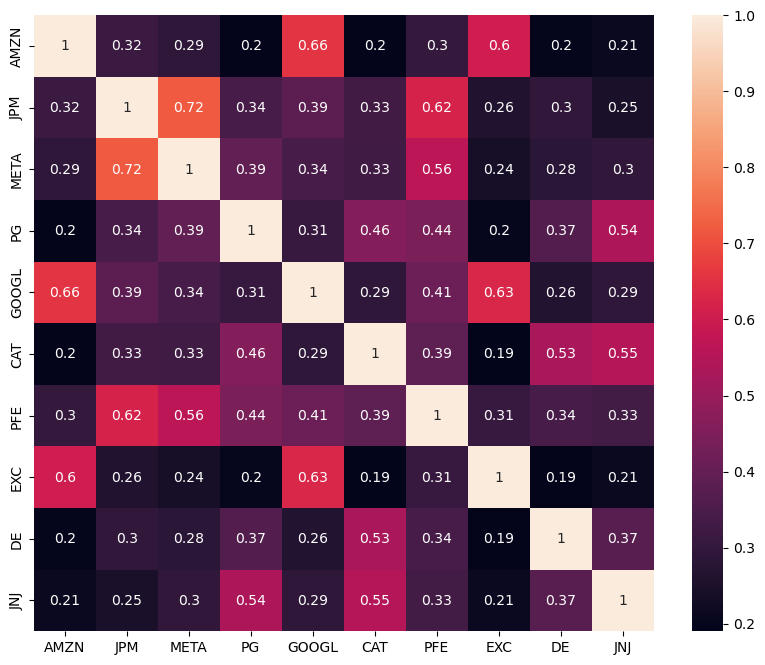

In [168]:
# Plot a heatmap showing the correlations between daily returns
# Strong positive correlations between Catterpillar and John Deere - both into heavy equipment and machinery
# META and Google - both into Tech and Cloud Computing
plt.figure(figsize = (10, 8))
sns.heatmap(daily_returns_df.drop(columns = ['Date']).corr(), annot = True);

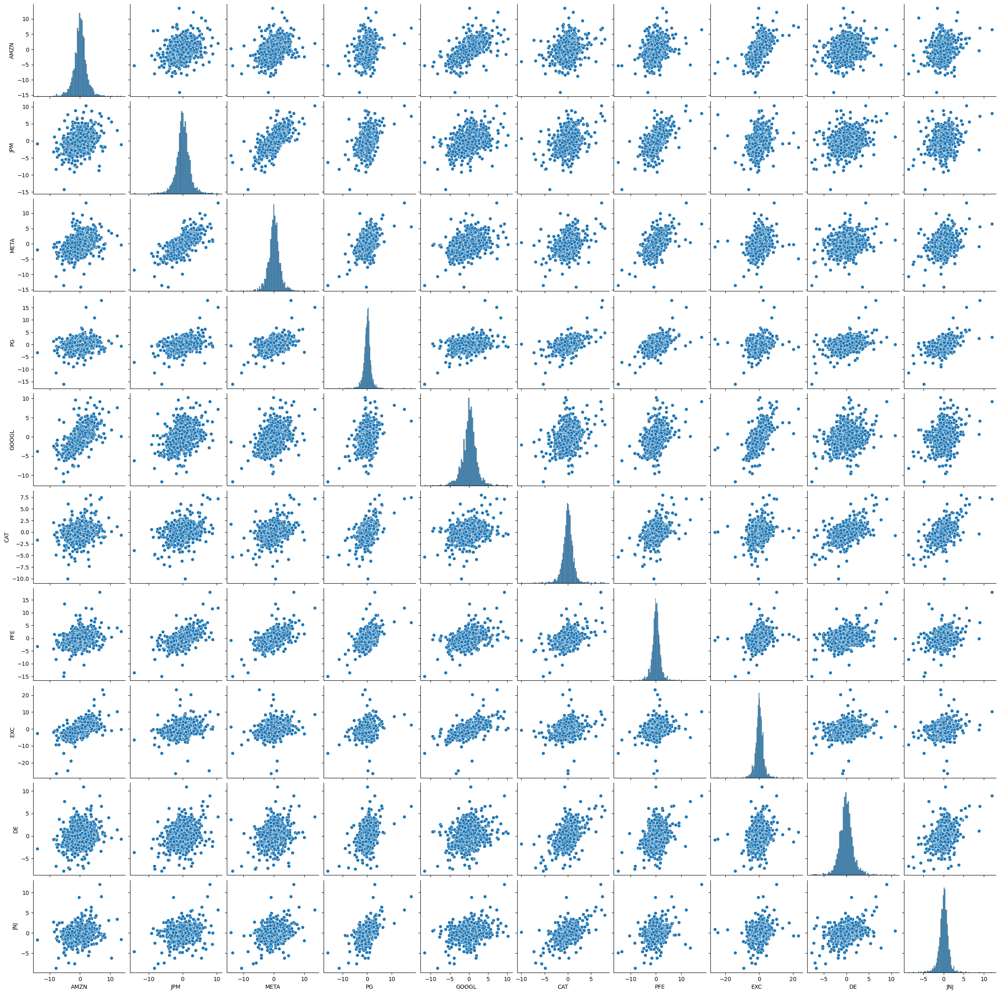

In [177]:
import seaborn as sns
import matplotlib.pyplot as plt

# Convert Date to datetime format
daily_returns_df["Date"] = pd.to_datetime(daily_returns_df["Date"])

# Drop Date column and plot the pairplot
sns.pairplot(daily_returns_df.drop(columns=["Date"]))

plt.show()


In [193]:
# Function to scale stock prices based on their initial starting price
# The objective of this function is to set all prices to start at a value of 1 
def price_scaling(raw_prices_df):
    scaled_prices_df = raw_prices_df.copy()
    for i in raw_prices_df.columns[1:]:
          scaled_prices_df[i] = raw_prices_df[i]/raw_prices_df[i][0]
    return scaled_prices_df

In [194]:
price_scaling(close_price_df)

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,2018-01-02,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2018-01-03,1.012775,1.001528,1.004557,0.986613,1.017061,1.009553,1.001019,1.017914,1.007410,0.998786
2,2018-01-04,1.017309,1.015283,1.010316,0.972720,1.021012,1.009481,1.015359,1.016040,1.009605,1.005847
3,2018-01-05,1.033751,1.031330,1.014619,0.964638,1.034551,1.017812,1.008841,1.029931,1.011526,1.006509
4,2018-01-08,1.048662,1.057246,1.019619,0.974993,1.038203,1.019105,1.010331,1.037813,1.000275,1.011804
...,...,...,...,...,...,...,...,...,...,...,...
1797,2025-02-26,3.605521,2.568955,3.365941,2.008447,3.230610,1.432408,2.937081,3.727668,1.033639,2.289388
1798,2025-02-27,3.511156,2.549608,3.380220,1.996139,3.151496,1.438117,2.940032,3.642126,1.021119,2.298342
1799,2025-02-28,3.570702,2.579228,3.381908,2.014829,3.184787,1.449448,3.003588,3.697236,1.034030,2.323334
1800,2025-03-03,3.448583,2.489917,3.276678,2.030783,3.123628,1.469298,2.957850,3.624475,1.026988,2.346723


In [195]:
# Let's create an array that holds random portfolio weights
# Note that portfolio weights must add up to 1 
import random

def generate_portfolio_weights(n):
    weights = []
    for i in range(n):
        weights.append(random.random())
        
    # let's make the sum of all weights add up to 1
    weights = weights/np.sum(weights)
    return weights

In [196]:
# Call the function (Run this cell multiple times to generate different outputs)
weights = generate_portfolio_weights(4)
print(weights)

[0.64369723 0.05724323 0.12230046 0.17675908]


In [197]:
# Let's define the "weights" list similar to the slides
weights = [0.032266, 0.094461, 0.117917, 0.132624, 0.145942, 0.128299, 0.10009, 0.007403, 0.088581, 0.152417]
weights

[0.032266,
 0.094461,
 0.117917,
 0.132624,
 0.145942,
 0.128299,
 0.10009,
 0.007403,
 0.088581,
 0.152417]

In [198]:
# Let's display "close_price_df" Pandas DataFrame
close_price_df

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,2018-01-02,59.450500,133.353851,142.165314,21.937349,53.466679,113.850273,88.111290,180.729614,25.560184,74.823502
1,2018-01-03,60.209999,133.557648,142.813110,21.643667,54.378876,114.937836,88.201065,183.967270,25.749573,74.732697
2,2018-01-04,60.479500,135.391891,143.631882,21.338905,54.590103,114.929665,89.464615,183.628571,25.805691,75.260971
3,2018-01-05,61.457001,137.531769,144.243698,21.161591,55.313984,115.878220,88.890282,186.138977,25.854790,75.310493
4,2018-01-08,62.343498,140.987885,144.954483,21.388767,55.509274,116.025406,89.021530,187.563522,25.567205,75.706688
...,...,...,...,...,...,...,...,...,...,...,...
1797,2025-02-26,214.350006,342.579987,478.519989,44.060001,172.729996,163.080002,258.790009,673.700012,26.420000,171.300003
1798,2025-02-27,208.740005,340.000000,480.549988,43.790001,168.500000,163.729996,259.049988,658.239990,26.100000,171.970001
1799,2025-02-28,212.279999,343.950012,480.790009,44.200001,170.279999,165.020004,264.649994,668.200012,26.430000,173.839996
1800,2025-03-03,205.020004,332.040009,465.829987,44.549999,167.009995,167.279999,260.619995,655.049988,26.250000,175.589996


In [199]:
# Scale stock prices using the "price_scaling" function that we defined earlier (make all stock values start at 1)
portfolio_df = close_price_df.copy()
scaled_df = price_scaling(portfolio_df)
scaled_df

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,2018-01-02,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2018-01-03,1.012775,1.001528,1.004557,0.986613,1.017061,1.009553,1.001019,1.017914,1.007410,0.998786
2,2018-01-04,1.017309,1.015283,1.010316,0.972720,1.021012,1.009481,1.015359,1.016040,1.009605,1.005847
3,2018-01-05,1.033751,1.031330,1.014619,0.964638,1.034551,1.017812,1.008841,1.029931,1.011526,1.006509
4,2018-01-08,1.048662,1.057246,1.019619,0.974993,1.038203,1.019105,1.010331,1.037813,1.000275,1.011804
...,...,...,...,...,...,...,...,...,...,...,...
1797,2025-02-26,3.605521,2.568955,3.365941,2.008447,3.230610,1.432408,2.937081,3.727668,1.033639,2.289388
1798,2025-02-27,3.511156,2.549608,3.380220,1.996139,3.151496,1.438117,2.940032,3.642126,1.021119,2.298342
1799,2025-02-28,3.570702,2.579228,3.381908,2.014829,3.184787,1.449448,3.003588,3.697236,1.034030,2.323334
1800,2025-03-03,3.448583,2.489917,3.276678,2.030783,3.123628,1.469298,2.957850,3.624475,1.026988,2.346723


In [200]:
# Use enumerate() method to obtain the stock names along with a counter "i" (0, 1, 2, 3,..etc.)
# This counter "i" will be used as an index to access elements in the "weights" list
initial_investment = 1000000
for i, stock in enumerate(scaled_df.columns[1:]):
    portfolio_df[stock] = weights[i] * scaled_df[stock]  * initial_investment
portfolio_df.round(1)

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,2018-01-02,32266.0,94461.0,117917.0,132624.0,145942.0,128299.0,100090.0,7403.0,88581.0,152417.0
1,2018-01-03,32678.2,94605.4,118454.3,130848.5,148431.9,129524.6,100192.0,7535.6,89237.3,152232.0
2,2018-01-04,32824.5,95904.6,119133.4,129006.1,149008.5,129515.4,101627.3,7521.7,89431.8,153308.1
3,2018-01-05,33355.0,97420.4,119640.9,127934.1,150984.4,130584.3,100974.9,7624.6,89602.0,153409.0
4,2018-01-08,33836.1,99868.6,120230.4,129307.5,151517.4,130750.2,101124.0,7682.9,88605.3,154216.1
...,...,...,...,...,...,...,...,...,...,...,...
1797,2025-02-26,116335.7,242666.0,396901.6,266368.3,471481.7,183776.5,293972.5,27595.9,91560.8,348941.6
1798,2025-02-27,113291.0,240838.5,398585.4,264736.0,459935.6,184509.0,294267.8,26962.7,90451.8,350306.4
1799,2025-02-28,115212.3,243636.5,398784.4,267214.6,464794.2,185962.7,300629.1,27370.6,91595.4,354115.6
1800,2025-03-03,111272.0,235200.0,386376.1,269330.6,455868.5,188509.5,296051.2,26832.0,90971.6,357680.4


In [201]:
# Assume that we have $1,000,000 that we would like to invest in one or more of the selected stocks
# Let's create a function that receives the following arguments: 
      # (1) Stocks closing prices
      # (2) Random weights 
      # (3) Initial investment amount
# The function will return a DataFrame that contains the following:
      # (1) Daily value (position) of each individual stock over the specified time period
      # (2) Total daily value of the portfolio 
      # (3) Percentage daily return 

def asset_allocation(df, weights, initial_investment):
    portfolio_df = df.copy()

    # Scale stock prices using the "price_scaling" function that we defined earlier (Make them all start at 1)
    scaled_df = price_scaling(df)
  
    for i, stock in enumerate(scaled_df.columns[1:]):
        portfolio_df[stock] = scaled_df[stock] * weights[i] * initial_investment

    # Sum up all values and place the result in a new column titled "portfolio value [$]" 
    # Note that we excluded the date column from this calculation
    portfolio_df['Portfolio Value [$]'] = portfolio_df[portfolio_df != 'Date'].sum(axis = 1, numeric_only = True)
            
    # Calculate the portfolio percentage daily return and replace NaNs with zeros
    portfolio_df['Portfolio Daily Return [%]'] = portfolio_df['Portfolio Value [$]'].pct_change(1) * 100 
    portfolio_df.replace(np.nan, 0, inplace = True)
    
    return portfolio_df

In [202]:
# Now let's put this code in a function and generate random weights
# Let's obtain the number of stocks under consideration (note that we ignored the "Date" column) 
n = len(close_price_df.columns)-1

# Let's generate random weights 
print('Number of stocks under consideration = {}'.format(n))
weights = generate_portfolio_weights(n).round(6)
print('Portfolio weights = {}'.format(weights))

# Let's test out the "asset_allocation" function
portfolio_df = asset_allocation(close_price_df, weights, 1000000)
portfolio_df.round(2)

Number of stocks under consideration = 10
Portfolio weights = [0.122368 0.147753 0.175257 0.100957 0.025451 0.042843 0.143432 0.058058
 0.11603  0.067852]


,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG,Portfolio Value [$],Portfolio Daily Return [%]
0,2018-01-02,122368.00,147753.00,175257.00,100957.00,25451.00,42843.00,143432.00,58058.00,116030.00,67852.00,1000001.00,0.00
1,2018-01-03,123931.29,147978.80,176055.58,99605.46,25885.22,43252.26,143578.14,59098.07,116889.72,67769.66,1004044.21,0.40
2,2018-01-04,124486.01,150011.10,177064.94,98202.92,25985.77,43249.19,145635.01,58989.27,117144.47,68248.71,1009017.39,0.50
3,2018-01-05,126498.01,152382.04,177819.17,97386.91,26330.35,43606.14,144700.08,59795.72,117367.36,68293.62,1014179.39,0.51
4,2018-01-08,128322.71,156211.33,178695.40,98432.39,26423.31,43661.52,144913.73,60253.34,116061.87,68652.90,1021628.51,0.73
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1797,2025-02-26,441200.35,379570.75,589904.64,202766.77,82222.26,61368.64,421271.42,216420.95,119933.12,155339.53,2669998.43,-0.20
1798,2025-02-27,429653.19,376712.18,592407.16,201524.22,80208.71,61613.24,421694.63,211454.54,118480.48,155947.11,2649695.45,-0.76
1799,2025-02-28,436939.62,381088.70,592703.05,203411.06,81056.02,62098.68,430810.60,214654.12,119978.51,157642.87,2680383.23,1.16
1800,2025-03-03,421996.24,367892.69,574260.79,205021.77,79499.45,62949.14,424250.37,210429.78,119161.41,159229.82,2624691.46,-2.08


In [203]:
# Plot the portfolio percentage daily return
plot_financial_data(portfolio_df[['Date', 'Portfolio Daily Return [%]']], 'Portfolio Percentage Daily Return [%]')

# Plot each stock position in our portfolio over time
# This graph shows how our initial investment in each individual stock grows over time
plot_financial_data(portfolio_df.drop(['Portfolio Value [$]', 'Portfolio Daily Return [%]'], axis = 1), 'Portfolio positions [$]')

# Plot the total daily value of the portfolio (sum of all positions)
plot_financial_data(portfolio_df[['Date', 'Portfolio Value [$]']], 'Total Portfolio Value [$]')



In [205]:
#define the simulation engine function 
# The function receives: 
    # (1) portfolio weights
    # (2) initial investment amount
# The function performs asset allocation and calculates portfolio statistical metrics including Sharpe ratio
# The function returns: 
    # (1) Expected portfolio return 
    # (2) Expected volatility 
    # (3) Sharpe ratio 
    # (4) Return on investment 
    # (5) Final portfolio value in dollars


def simulation_engine(weights, initial_investment):
    # Perform asset allocation using the random weights (sent as arguments to the function)
    portfolio_df = asset_allocation(close_price_df, weights, initial_investment)
  
    # Calculate the return on the investment 
    # Return on investment is calculated using the last final value of the portfolio compared to its initial value
    return_on_investment = ((portfolio_df['Portfolio Value [$]'][-1:] - 
                             portfolio_df['Portfolio Value [$]'][0])/ 
                             portfolio_df['Portfolio Value [$]'][0]) * 100
  
    # Daily change of every stock in the portfolio (Note that we dropped the date, portfolio daily worth and daily % returns) 
    portfolio_daily_return_df = portfolio_df.drop(columns = ['Date', 'Portfolio Value [$]', 'Portfolio Daily Return [%]'])
    portfolio_daily_return_df = portfolio_daily_return_df.pct_change(1) 
  
    # Portfolio Expected Return formula
    expected_portfolio_return = np.sum(weights * portfolio_daily_return_df.mean() ) * 252
  
    # Portfolio volatility (risk) formula
    # The risk of an asset is measured using the standard deviation which indicates the dispertion away from the mean
    # The risk of a portfolio is not a simple sum of the risks of the individual assets within the portfolio
    # Portfolio risk must consider correlations between assets within the portfolio which is indicated by the covariance 
    # The covariance determines the relationship between the movements of two random variables
    # When two stocks move together, they have a positive covariance when they move inversely, the have a negative covariance 

    covariance = portfolio_daily_return_df.cov() * 252 
    expected_volatility = np.sqrt(np.dot(weights.T, np.dot(covariance, weights)))

    # Check out the chart for the 10-years U.S. treasury at https://ycharts.com/indicators/10_year_treasury_rate
    rf = 0.03 # Try to set the risk free rate of return to 1% (assumption)

    # Calculate Sharpe ratio
    sharpe_ratio = (expected_portfolio_return - rf)/expected_volatility 
    return expected_portfolio_return, expected_volatility, sharpe_ratio, portfolio_df['Portfolio Value [$]'][-1:].values[0], return_on_investment.values[0]
  
    
    

In [206]:
# Let's test out the "simulation_engine" function and print out statistical metrics
# Define the initial investment amount
initial_investment = 1000000
portfolio_metrics = simulation_engine(weights, initial_investment)

In [207]:
print('Expected Portfolio Annual Return = {:.2f}%'.format(portfolio_metrics[0] * 100))
print('Portfolio Standard Deviation (Volatility) = {:.2f}%'.format(portfolio_metrics[1] * 100))
print('Sharpe Ratio = {:.2f}'.format(portfolio_metrics[2]))
print('Portfolio Final Value = ${:.2f}'.format(portfolio_metrics[3]))
print('Return on Investment = {:.2f}%'.format(portfolio_metrics[4]))


Expected Portfolio Annual Return = 16.91%
Portfolio Standard Deviation (Volatility) = 20.06%
Sharpe Ratio = 0.69
Portfolio Final Value = $2577740.85
Return on Investment = 157.77%


In [208]:
# Set the number of simulation runs
sim_runs = 10000
initial_investment = 1000000

# Placeholder to store all weights
weights_runs = np.zeros((sim_runs, n))

# Placeholder to store all Sharpe ratios
sharpe_ratio_runs = np.zeros(sim_runs)

# Placeholder to store all expected returns
expected_portfolio_returns_runs = np.zeros(sim_runs)

# Placeholder to store all volatility values
volatility_runs = np.zeros(sim_runs)

# Placeholder to store all returns on investment
return_on_investment_runs = np.zeros(sim_runs)

# Placeholder to store all final portfolio values
final_value_runs = np.zeros(sim_runs)

for i in range(sim_runs):
    # Generate random weights 
    weights = generate_portfolio_weights(n)
    # Store the weights
    weights_runs[i,:] = weights
    
    # Call "simulation_engine" function and store Sharpe ratio, return and volatility
    # Note that asset allocation is performed using the "asset_allocation" function  
    expected_portfolio_returns_runs[i], volatility_runs[i], sharpe_ratio_runs[i], final_value_runs[i], return_on_investment_runs[i] = simulation_engine(weights, initial_investment)
    print("Simulation Run = {}".format(i))   
    print("Weights = {}, Final Value = ${:.2f}, Sharpe Ratio = {:.2f}".format(weights_runs[i].round(3), final_value_runs[i], sharpe_ratio_runs[i]))   
    print('\n')

    

Simulation Run = 0
Weights = [0.073 0.144 0.038 0.135 0.062 0.195 0.101 0.048 0.104 0.099], Final Value = $2270547.19, Sharpe Ratio = 0.64


Simulation Run = 1
Weights = [0.078 0.069 0.12  0.355 0.09  0.054 0.012 0.16  0.042 0.02 ], Final Value = $2584901.70, Sharpe Ratio = 0.70


Simulation Run = 2
Weights = [0.096 0.088 0.078 0.16  0.05  0.062 0.022 0.163 0.143 0.137], Final Value = $2468697.23, Sharpe Ratio = 0.69


Simulation Run = 3
Weights = [0.003 0.256 0.175 0.022 0.052 0.276 0.104 0.003 0.072 0.038], Final Value = $2275333.73, Sharpe Ratio = 0.57


Simulation Run = 4
Weights = [0.187 0.171 0.109 0.099 0.127 0.044 0.096 0.011 0.062 0.096], Final Value = $2669035.41, Sharpe Ratio = 0.73


Simulation Run = 5
Weights = [0.014 0.193 0.007 0.122 0.211 0.134 0.096 0.021 0.011 0.19 ], Final Value = $2456609.04, Sharpe Ratio = 0.69


Simulation Run = 6
Weights = [0.11  0.125 0.102 0.101 0.211 0.053 0.018 0.013 0.105 0.161], Final Value = $2543461.59, Sharpe Ratio = 0.71


Simulation Ru

In [218]:
# List all Sharpe ratios generated from the simulation
sharpe_ratio_runs

array([0.63719011, 0.70279255, 0.69212025, ..., 0.73910795, 0.74608306,
       0.70362225])

In [214]:
# Return the index of the maximum Sharpe ratio (Best simulation run) 
sharpe_ratio_runs.argmax()

3644

In [215]:
# Return the maximum Sharpe ratio value
sharpe_ratio_runs.max()

0.7990830207340585

In [216]:
weights_runs

array([[0.07343613, 0.1441972 , 0.0384499 , ..., 0.04836927, 0.10397739,
        0.09909274],
       [0.07781286, 0.06875324, 0.12049492, ..., 0.1597815 , 0.04151673,
        0.01992357],
       [0.0962219 , 0.08782956, 0.07808583, ..., 0.16310991, 0.14281379,
        0.13715845],
       ...,
       [0.03668578, 0.11277612, 0.08506341, ..., 0.23550935, 0.08407424,
        0.23621295],
       [0.16025493, 0.17411435, 0.08126093, ..., 0.19004567, 0.02980741,
        0.07028495],
       [0.08026589, 0.10778956, 0.0445707 , ..., 0.15620688, 0.11174064,
        0.03478722]])

In [217]:
# Obtain the portfolio weights that correspond to the maximum Sharpe ratio (Golden set of weights!)
weights_runs[sharpe_ratio_runs.argmax(), :]

array([0.15720138, 0.04295223, 0.2012364 , 0.01696729, 0.03447933,
       0.08223737, 0.07459446, 0.16192545, 0.00402127, 0.22438482])

In [220]:
# List all Sharpe ratios generated from the simulation
print("All Sharpe Ratios:\n", sharpe_ratio_runs)

# Return the index of the maximum Sharpe ratio (Best simulation run)
best_index = sharpe_ratio_runs.argmax()
print("\nIndex of Best Sharpe Ratio:", best_index)

# Return the maximum Sharpe ratio value
max_sharpe = sharpe_ratio_runs.max()
print("\nMaximum Sharpe Ratio:", max_sharpe)

# Obtain the portfolio weights that correspond to the maximum Sharpe ratio (Golden set of weights!)
golden_weights = weights_runs[best_index, :]
print("\nOptimal Portfolio Weights:", golden_weights)


All Sharpe Ratios:
 [0.63719011 0.70279255 0.69212025 ... 0.73910795 0.74608306 0.70362225]

Index of Best Sharpe Ratio: 3644

Maximum Sharpe Ratio: 0.7990830207340585

Optimal Portfolio Weights: [0.15720138 0.04295223 0.2012364  0.01696729 0.03447933 0.08223737
 0.07459446 0.16192545 0.00402127 0.22438482]


In [225]:
# Return Sharpe ratio, volatility corresponding to the best weights allocation (maximum Sharpe ratio)
optimal_portfolio_return, optimal_volatility, optimal_sharpe_ratio, highest_final_value, 
optimal_return_on_investment = simulation_engine(weights_runs[sharpe_ratio_runs.argmax(), :], initial_investment)


result = simulation_engine(weights_runs[sharpe_ratio_runs.argmax(), :], initial_investment)
print("Simulation Output:", result)
print("Expected 5 values, got:", len(result))
# Assign values from the function output
optimal_portfolio_return, optimal_volatility, optimal_sharpe_ratio, highest_final_value, optimal_return_on_investment = simulation_engine(weights_runs[sharpe_ratio_runs.argmax(), :], initial_investment)

# Print values to confirm they exist
print("Portfolio Return:", optimal_portfolio_return)
print("Volatility:", optimal_volatility)
print("Sharpe Ratio:", optimal_sharpe_ratio)
print("Final Value:", highest_final_value)
print("Return on Investment:", optimal_return_on_investment)
optimal_portfolio_return, optimal_volatility, optimal_sharpe_ratio, highest_final_value, optimal_return_on_investment = simulation_engine(weights_runs[sharpe_ratio_runs.argmax(), :], initial_investment)

print("Portfolio Return:", optimal_portfolio_return)
print("Volatility:", optimal_volatility)
print("Sharpe Ratio:", optimal_sharpe_ratio)
print("Final Value:", highest_final_value)
print("Return on Investment:", optimal_return_on_investment)

if "optimal_portfolio_return" not in globals():
    print("Variable 'optimal_portfolio_return' is not defined before usage!")

    
    

Simulation Output: (0.19062555478926024, 0.20101234868149923, 0.7990830207340585, 2866174.649649083, 186.61746496490838)
Expected 5 values, got: 5
Portfolio Return: 0.19062555478926024
Volatility: 0.20101234868149923
Sharpe Ratio: 0.7990830207340585
Final Value: 2866174.649649083
Return on Investment: 186.61746496490838
Portfolio Return: 0.19062555478926024
Volatility: 0.20101234868149923
Sharpe Ratio: 0.7990830207340585
Final Value: 2866174.649649083
Return on Investment: 186.61746496490838


In [226]:
print('Best Portfolio Metrics Based on {} Monte Carlo Simulation Runs:'.format(sim_runs))
print('  - Portfolio Expected Annual Return = {:.02f}%'.format(optimal_portfolio_return * 100))
print('  - Portfolio Standard Deviation (Volatility) = {:.02f}%'.format(optimal_volatility * 100))
print('  - Sharpe Ratio = {:.02f}'.format(optimal_sharpe_ratio))
print('  - Final Value = ${:.02f}'.format(highest_final_value))
print('  - Return on Investment = {:.02f}%'.format(optimal_return_on_investment))


Best Portfolio Metrics Based on 10000 Monte Carlo Simulation Runs:
  - Portfolio Expected Annual Return = 19.06%
  - Portfolio Standard Deviation (Volatility) = 20.10%
  - Sharpe Ratio = 0.80
  - Final Value = $2866174.65
  - Return on Investment = 186.62%


In [228]:
#Create a DataFrame that contains volatility, return, and Sharpe ratio for all simualation runs
sim_out_df = pd.DataFrame({'Volatility': volatility_runs.tolist(), 'Portfolio_Return': expected_portfolio_returns_runs.tolist(), 'Sharpe_Ratio': sharpe_ratio_runs.tolist() })
sim_out_df



,Volatility,Portfolio_Return,Sharpe_Ratio
0,0.178958,0.144030,0.637190
1,0.204251,0.173546,0.702793
2,0.189679,0.161280,0.692120
3,0.200642,0.144647,0.571399
4,0.200474,0.175411,0.725334
...,...,...,...
9995,0.192465,0.146739,0.606547
9996,0.211620,0.179381,0.705894
9997,0.209200,0.184622,0.739108
9998,0.220713,0.194670,0.746083


In [229]:
# Plot volatility vs. return for all simulation runs
# Highlight the volatility and return that corresponds to the highest Sharpe ratio
import plotly.graph_objects as go
fig = px.scatter(sim_out_df, x = 'Volatility', y = 'Portfolio_Return', color = 'Sharpe_Ratio', size = 'Sharpe_Ratio', hover_data = ['Sharpe_Ratio'] )
fig.update_layout({'plot_bgcolor': "white"})
fig.show()


# Use this code if Sharpe ratio is negative
# fig = px.scatter(sim_out_df, x = 'Volatility', y = 'Portfolio_Return', color = 'Sharpe_Ratio', hover_data = ['Sharpe_Ratio'] )




In [230]:
# Let's highlight the point with the highest Sharpe ratio
fig = px.scatter(sim_out_df, x = 'Volatility', y = 'Portfolio_Return', color = 'Sharpe_Ratio', size = 'Sharpe_Ratio', hover_data = ['Sharpe_Ratio'] )
fig.add_trace(go.Scatter(x = [optimal_volatility], y = [optimal_portfolio_return], mode = 'markers', name = 'Optimal Point', marker = dict(size=[40], color = 'red')))
fig.update_layout(coloraxis_colorbar = dict(y = 0.7, dtick = 5))
fig.update_layout({'plot_bgcolor': "white"})

fig.show()


In [232]:
# Use Pandas to read stock data (the csv file is included in the course package) 
JPM_df = pd.read_csv('JPM.csv')
JPM_df

,Date,Open,High,Low,Close,Volume,Adj Close
0,NaN,JPM,JPM,JPM,JPM,JPM,JPM
1,2018-01-11,110.66999816894531,110.93000030517578,110.05000305175781,110.83999633789062,13676800,90.94145965576172
2,2018-01-12,111.6500015258789,112.8499984741211,110.83999633789062,112.66999816894531,18884200,92.44293975830078
3,2018-01-16,111.51000213623047,113.43000030517578,111.06999969482422,112.2699966430664,22703300,92.1147232055664
4,2018-01-17,111.88999938964844,113.30000305175781,111.30999755859375,112.98999786376953,14940300,92.7054672241211
...,...,...,...,...,...,...,...
1790,2025-02-25,262.2300109863281,263.0,253.35000610351562,257.3999938964844,9608400,257.3999938964844
1791,2025-02-26,257.1600036621094,260.9100036621094,256.92999267578125,258.7900085449219,5943600,258.7900085449219
1792,2025-02-27,260.17999267578125,263.6400146484375,257.8599853515625,259.04998779296875,8204400,259.04998779296875
1793,2025-02-28,260.7300109863281,264.80999755859375,257.8900146484375,264.6499938964844,10467100,264.6499938964844


In [233]:
JPM_df.isnull().sum()

Date         1
Open         0
High         0
Low          0
Close        0
Volume       0
Adj Close    0
dtype: int64

In [243]:
JPM_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1794 entries, 0 to 1793
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   nan     1794 non-null   object 
 1   JPM     1794 non-null   object 
 2   JPM     1794 non-null   object 
 3   JPM     1794 non-null   object 
 4   JPM     1794 non-null   object 
 5   JPM     1794 non-null   object 
 6   nan     1794 non-null   float64
 7   0.0     1794 non-null   float64
dtypes: float64(2), object(6)
memory usage: 112.3+ KB


In [251]:
# Calculate the percentage daily return
# Note that we had to replace the first row with zeros instead of NaN
JPM_df['Daily Return'] = JPM_df['Adj Close'].pct_change() * 100
JPM_df['Daily Return'].fillna(0, inplace=True)

print(JPM_df.head())


/var/folders/s0/hts3dbss56x0x2f85v7w1p6r0000gn/T/ipykernel_91311/4023323321.py:4: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





         Date                Open                High                 Low  \
0  2018-01-12   111.6500015258789   112.8499984741211  110.83999633789062   
1  2018-01-16  111.51000213623047  113.43000030517578  111.06999969482422   
2  2018-01-17  111.88999938964844  113.30000305175781  111.30999755859375   
3  2018-01-18  112.76000213623047  113.72000122070312   112.2699966430664   
4  2018-01-19  113.94000244140625  114.33999633789062  112.80000305175781   

                Close    Volume  Adj Close  Daily Return  
0  112.66999816894531  18884200  92.442940      0.000000  
1   112.2699966430664  22703300  92.114723     -0.355048  
2  112.98999786376953  14940300  92.705467      0.641313  
3  113.26000213623047  14572900  92.927010      0.238974  
4  113.01000213623047  18785500  92.721886     -0.220737  


In [253]:
# Convert all numerical columns to float
cols_to_convert = ['Open', 'High', 'Low', 'Close', 'Volume']
JPM_df[cols_to_convert] = JPM_df[cols_to_convert].apply(pd.to_numeric, errors='coerce')

# Now describe will work on all numeric columns
print(JPM_df.describe())


              Open         High          Low        Close        Volume  \
count  1793.000000  1793.000000  1793.000000  1793.000000  1.793000e+03   
mean    140.592633   141.953731   139.245934   140.618198  1.313581e+07   
std      39.102532    39.338203    38.880514    39.139613  6.557170e+06   
min      81.559998    83.750000    76.910004    79.029999  3.220500e+06   
25%     111.699997   112.910004   110.790001   111.879997  8.907300e+06   
50%     132.520004   133.899994   131.429993   132.479996  1.147260e+07   
75%     156.690002   158.050003   155.570007   156.820007  1.508340e+07   
max     278.679993   280.250000   277.220001   279.950012  5.441880e+07   

         Adj Close  Daily Return  
count  1793.000000   1793.000000  
mean    129.398237      0.074985  
std      43.277319      1.855942  
min      68.480942    -14.964893  
25%      93.969017     -0.775222  
50%     120.422363      0.066942  
75%     144.956039      0.917882  
max     279.950012     18.012477  


In [254]:
JPM_df

,Date,Open,High,Low,Close,Volume,Adj Close,Daily Return
0,2018-01-12,111.650002,112.849998,110.839996,112.669998,18884200,92.442940,0.000000
1,2018-01-16,111.510002,113.430000,111.070000,112.269997,22703300,92.114723,-0.355048
2,2018-01-17,111.889999,113.300003,111.309998,112.989998,14940300,92.705467,0.641313
3,2018-01-18,112.760002,113.720001,112.269997,113.260002,14572900,92.927010,0.238974
4,2018-01-19,113.940002,114.339996,112.800003,113.010002,18785500,92.721886,-0.220737
...,...,...,...,...,...,...,...,...
1788,2025-02-25,262.230011,263.000000,253.350006,257.399994,9608400,257.399994,-1.507616
1789,2025-02-26,257.160004,260.910004,256.929993,258.790009,5943600,258.790009,0.540021
1790,2025-02-27,260.179993,263.640015,257.859985,259.049988,8204400,259.049988,0.100460
1791,2025-02-28,260.730011,264.809998,257.890015,264.649994,10467100,264.649994,2.161747


In [255]:
# Plot interactive chart
plot_financial_data(JPM_df.drop(['Volume', 'Daily Return'], axis = 1), 'JPMorgan Chase & Co. Stock Price [$]')

In [256]:
# Plot trading volume (Note that the position of the Volume column is different compared to Amazon's DataFrame)
plot_financial_data(JPM_df.iloc[:,[0,6]], 'JPMorgan Chase & Co. Trading Volume')

In [257]:
# Plot % Daily Returns
plot_financial_data(JPM_df.iloc[:,[0,7]], 'JPMorgan Chase & Co. Percentage Daily Return [%]')

In [259]:
# Apply the function to the "Daily Return" Column and place the result in "Trend" column
JPM_df['Trend'] = JPM_df['Daily Return'].apply(percentage_return_classifier)
JPM_df

,Date,Open,High,Low,Close,Volume,Adj Close,Daily Return,Trend
0,2018-01-12,111.650002,112.849998,110.839996,112.669998,18884200,92.442940,0.000000,Insignificant Change
1,2018-01-16,111.510002,113.430000,111.070000,112.269997,22703300,92.114723,-0.355048,Negative Change
2,2018-01-17,111.889999,113.300003,111.309998,112.989998,14940300,92.705467,0.641313,Positive Change
3,2018-01-18,112.760002,113.720001,112.269997,113.260002,14572900,92.927010,0.238974,Insignificant Change
4,2018-01-19,113.940002,114.339996,112.800003,113.010002,18785500,92.721886,-0.220737,Insignificant Change
...,...,...,...,...,...,...,...,...,...
1788,2025-02-25,262.230011,263.000000,253.350006,257.399994,9608400,257.399994,-1.507616,Negative Change
1789,2025-02-26,257.160004,260.910004,256.929993,258.790009,5943600,258.790009,0.540021,Positive Change
1790,2025-02-27,260.179993,263.640015,257.859985,259.049988,8204400,259.049988,0.100460,Insignificant Change
1791,2025-02-28,260.730011,264.809998,257.890015,264.649994,10467100,264.649994,2.161747,Positive Change


In [260]:
# Count distinct values in the Trend column
trend_summary = JPM_df['Trend'].value_counts()
trend_summary

Trend
Positive Change          703
Negative Change          613
Insignificant Change     349
Large Negative Change     57
Large Positive Change     56
Bull Run                   9
Bear Sell Off              6
Name: count, dtype: int64

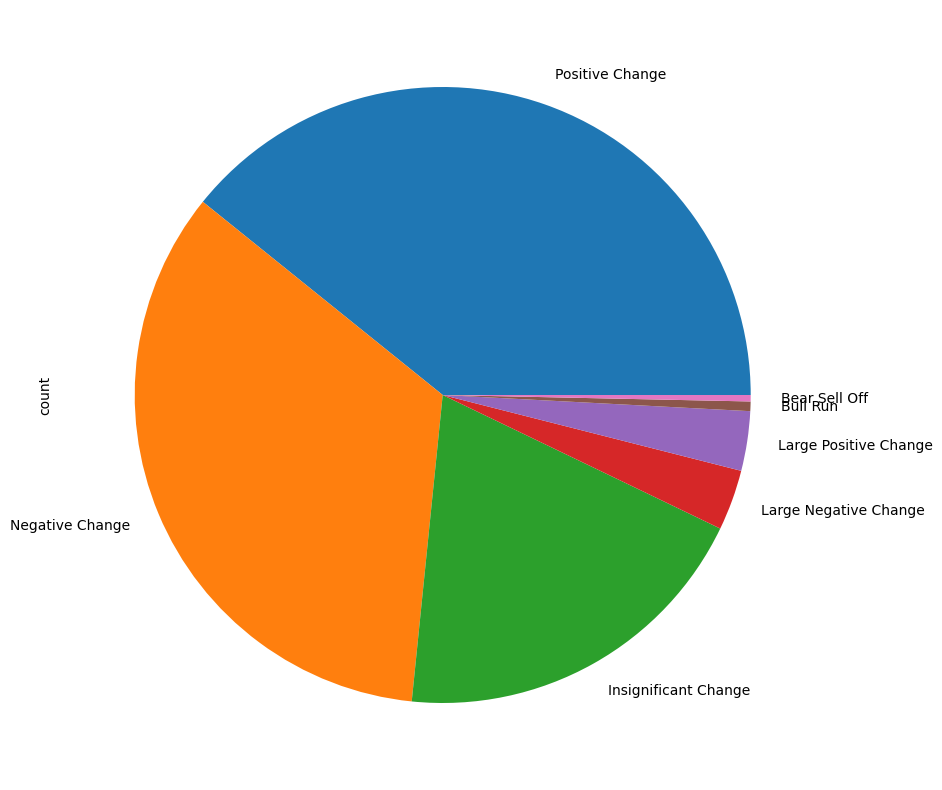

In [261]:
# Plot a pie chart using Matplotlib Library
plt.figure(figsize = (10, 10))
trend_summary.plot(kind = 'pie', y = 'Trend');

In [262]:
# Set the date to be the index for the Pandas DataFrame
# This is critical to show the date on the x-axis when using cufflinks
JPM_df.set_index(['Date'], inplace = True)
JPM_df

,Open,High,Low,Close,Volume,Adj Close,Daily Return,Trend
Date,,,,,,,,
2018-01-12,111.650002,112.849998,110.839996,112.669998,18884200,92.442940,0.000000,Insignificant Change
2018-01-16,111.510002,113.430000,111.070000,112.269997,22703300,92.114723,-0.355048,Negative Change
2018-01-17,111.889999,113.300003,111.309998,112.989998,14940300,92.705467,0.641313,Positive Change
2018-01-18,112.760002,113.720001,112.269997,113.260002,14572900,92.927010,0.238974,Insignificant Change
2018-01-19,113.940002,114.339996,112.800003,113.010002,18785500,92.721886,-0.220737,Insignificant Change
...,...,...,...,...,...,...,...,...
2025-02-25,262.230011,263.000000,253.350006,257.399994,9608400,257.399994,-1.507616,Negative Change
2025-02-26,257.160004,260.910004,256.929993,258.790009,5943600,258.790009,0.540021,Positive Change
2025-02-27,260.179993,263.640015,257.859985,259.049988,8204400,259.049988,0.100460,Insignificant Change


In [263]:
# Plot Candlestick Figure using Cufflinks
figure = cf.QuantFig(JPM_df, title = 'JPMorgan and Chase Co. Candlestick Chart', name = 'JPM')
figure.add_sma(periods =[30, 100], column = 'Close', color = ['magenta', 'green'])
figure.iplot(theme = 'white', up_color = 'green', down_color = 'red')

In [325]:
# Plot Candlestick figure using Cufflinks
import cufflinks as cf
# Plot Candlestick figure using Cufflinks
figure = cf.QuantFig(JPM_df, title='JPMorgan and Chase Co. Candlestick Chart', name='JP Morgan and Chase')

# Add Bollinger Bands with a specific color
figure.add_bollinger_bands(periods=20, boll_std=2, colors=['green', 'red'], fill=True)

# Plot the figure
figure.iplot()


In [313]:
JPM_df = pd.read_csv("JPM.csv", header=[0, 1])  # Read multi-row headers
JPM_df.columns = JPM_df.columns.get_level_values(0)  # Keep only first row as headers
JPM_df = JPM_df[1:].reset_index(drop=True)  # Drop the second row and reset index
print(JPM_df.head())


         Date        Open        High         Low       Close    Volume  \
0  2018-01-12  111.650002  112.849998  110.839996  112.669998  18884200   
1  2018-01-16  111.510002  113.430000  111.070000  112.269997  22703300   
2  2018-01-17  111.889999  113.300003  111.309998  112.989998  14940300   
3  2018-01-18  112.760002  113.720001  112.269997  113.260002  14572900   
4  2018-01-19  113.940002  114.339996  112.800003  113.010002  18785500   

   Adj Close  
0  92.442940  
1  92.114723  
2  92.705467  
3  92.927010  
4  92.721886  


In [318]:
# Plot scaled stock prices
plot_financial_data(price_scaling(close_price_df), 'Scaled Stock Closing Prices [$]')

In [319]:
# Plot interactive plot for volatility
fig = px.line(sim_out_df, y = 'Volatility')
fig.show()

Define a new "weights" list that contains equal allocation among all assets.
Call "simulation_engine" function and send it the new weights. Record the Sharpe ratio and portfolio final value.
Assume that the risk-free rate is now set to 1%. How does that change impact Sharpe ratio? confirm your answer by changing the risk free-rate, running the code, and recording the new Sharpe ratio.

In [320]:
# Assume equal weights allocation
weights = np.ones(10) * 0.1
weights

array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1])

In [321]:
# Let's test out the "simulation_engine" function and print out statistical metrics
# Define the initial investment amount
initial_investment = 1000000
portfolio_metrics = simulation_engine(weights, initial_investment)

print('Expected Portfolio Annual Return = {:.2f}%'.format(portfolio_metrics[0] * 100))
print('Portfolio Standard Deviation (Volatility) = {:.2f}%'.format(portfolio_metrics[1] * 100))
print('Sharpe Ratio = {:.2f}'.format(portfolio_metrics[2]))
print('Portfolio Final Value = ${:.2f}'.format(portfolio_metrics[3]))
print('Return on Investment = {:.2f}%'.format(portfolio_metrics[4]))

Expected Portfolio Annual Return = 16.58%
Portfolio Standard Deviation (Volatility) = 19.05%
Sharpe Ratio = 0.71
Portfolio Final Value = $2544167.83
Return on Investment = 154.42%
